In [28]:
import os
import numpy as np
import tifffile as tiff
import matplotlib.pyplot as plt
import cv2

# Define folder path
base_folder = "./IDP Group A"

# Define wavelength list (450 nm to 950 nm in 20 nm steps)
wavelengths = list(range(450, 951, 20))

# Define subfolders
sample_folders = [f"d{i}" for i in range(1, 15)]  # d1 to d14
dark_folder = "dark"
white_folder = "white"
reference_folder = "reference image"


# Load white and dark images
def load_cube(folder_path):
    tif_files = [f for f in os.listdir(folder_path) if f.lower().endswith(".tif")]
    tif_files.sort()

    cube = []
    for tif_file in tif_files:
        tif_path = os.path.join(folder_path, tif_file)
        tif = tiff.imread(tif_path)
        cube.append(tif)

    cube = np.array(cube)

    return cube


# Load dark and white reference cubes
dark_cube = load_cube(os.path.join(base_folder, dark_folder))
white_cube = load_cube(os.path.join(base_folder, white_folder))
reference_cube = load_cube(os.path.join(base_folder, reference_folder))


# Avoid division by zero
denominator = white_cube - dark_cube
denominator[denominator == 0] = 1e-6

# Load and compute reflectance for each sample
defect_cubes = {}

for folder in sample_folders:
    sample_cube = load_cube(os.path.join(base_folder, folder))
    R = (sample_cube - dark_cube) / denominator
    defect_cubes[folder] = R  # Shape: (bands, height, width)

In [29]:
R_sample = (reference_cube - dark_cube) / denominator

print(f"R_sample.shape: {R_sample.shape}")

R_sample.shape: (26, 1040, 1392)


In [30]:
# R_d1 = defect_cubes["d1"] # Example: Access reflectance cube for d1


def plot_image(image, title=""):
    # Plot the image
    plt.figure(figsize=(6, 5))
    plt.imshow(image, cmap="gray")
    plt.colorbar(label="Pixel Value")
    plt.title(title)
    plt.axis("off")
    plt.tight_layout()
    plt.show()


def plot_example_reflectance(defect_cubes, sample_name, wavelength):
    # Get reflectance cube
    R = defect_cubes[sample_name]

    # Extract 2D image at selected wavelength
    reflectance_image = R[wavelengths.index(wavelength), :, :]
    title = f"Reflectance of {sample_name} at {wavelength} nm"

    plot_image(reflectance_image, title)


def plot_original_tif(tif_path):
    image = tiff.imread(tif_path)

    plot_image(image, tif_path)


def get_example_reflectance(defect_cubes, sample_name, wavelength):
    # Get reflectance cube
    R = defect_cubes[sample_name]

    # Extract 2D image at selected wavelength
    reflectance_image = R[wavelengths.index(wavelength), :, :]

    return reflectance_image


# plot_example_reflectance(defect_cubes, "d11", 450)
# plot_original_tif("IDP Group A/d11/Image_Cube_450.tif")

In [31]:
# import cv2
# import numpy as np
# import matplotlib.pyplot as plt


# def detect_alignment_points(img):
#     # 1. Convert to grayscale (if not already)
#     if len(img.shape) == 3:
#         gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
#     else:
#         gray = img.copy()

#     # --- FIX: normalise to [0,255] and convert to uint8 ---
#     gray = cv2.normalize(gray, None, 0, 255, cv2.NORM_MINMAX)
#     gray = gray.astype(np.uint8)

#     # 2. Enhance contrast
#     gray = cv2.equalizeHist(gray)

#     # 3. Adaptive threshold
#     thresh = cv2.adaptiveThreshold(
#         gray, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 51, -5
#     )

#     # 4. Morphological cleaning
#     kernel = np.ones((3, 3), np.uint8)
#     clean = cv2.morphologyEx(thresh, cv2.MORPH_OPEN, kernel)

#     # 5. Invert if "+" is dark
#     if np.mean(clean) > 127:
#         clean = cv2.bitwise_not(clean)

#     # 6. Connected components
#     num_labels, labels, stats, centroids = cv2.connectedComponentsWithStats(clean)

#     # 7. Filter "+" candidates
#     candidates = []
#     for i in range(1, num_labels):
#         x, y, w, h, area = stats[i]
#         aspect_ratio = w / h if h != 0 else 0
#         if 0.6 < aspect_ratio < 1.4 and 50 < area < 55:
#             candidates.append(centroids[i])

#     candidates = np.array(candidates)

#     # 8. Sort points (top-to-bottom, left-to-right)
#     if len(candidates) == 4:
#         sorted_points = candidates[np.lexsort((candidates[:, 0], candidates[:, 1]))]
#     else:
#         sorted_points = candidates

#     return sorted_points, clean


# # Example usage
# reflectance_image_1 = defect_cubes["d1"][wavelengths.index(450), :, :]
# reflectance_image_2 = defect_cubes["d2"][wavelengths.index(450), :, :]

# pts1, mask1 = detect_alignment_points(reflectance_image_1)
# pts2, mask2 = detect_alignment_points(reflectance_image_2)

# # --- Corrected plotting section ---
# plt.figure(figsize=(12, 6))
# plt.subplot(1, 2, 1)
# plt.imshow(reflectance_image_1, cmap="gray")
# plt.scatter(pts1[:, 0], pts1[:, 1], c="r", marker="+", s=200)
# # plt.title('Image 1 with Detected "+" Points')

# plt.subplot(1, 2, 2)
# plt.imshow(reflectance_image_2, cmap="gray")
# plt.scatter(pts2[:, 0], pts2[:, 1], c="r", marker="+", s=200)
# # plt.title('Image 2 with Detected "+" Points')
# plt.show()

In [32]:
# for i in wavelengths:
#     plot_example_reflectance(defect_cubes, "d13", i)

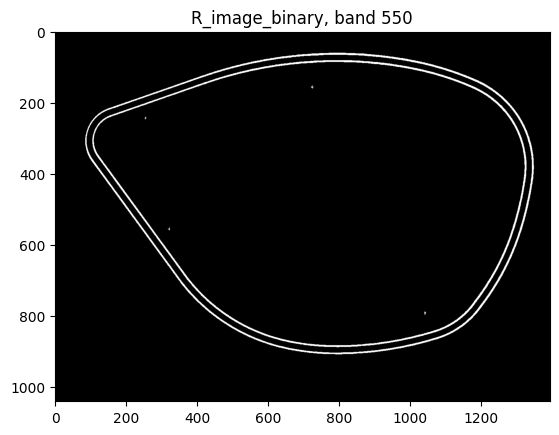

In [33]:
band = 550

R_image = R_sample[wavelengths.index(band), :, :]
R_image_norm = R_image / np.max(R_image)
R_image_norm = (R_image_norm * 255).astype(np.uint8)
_, R_image_binary = cv2.threshold(R_image_norm, 60, 255, cv2.THRESH_BINARY_INV)

plt.imshow(R_image_binary, cmap="gray")
plt.title(f"R_image_binary, band {band}")
plt.show()

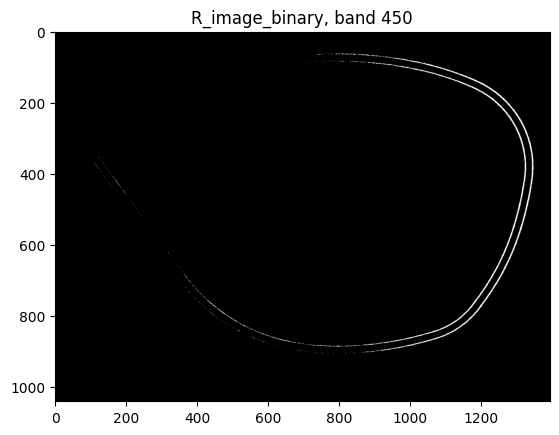

In [46]:
R_image = R_sample[wavelengths.index(450), :, :]
R_image_norm = R_image / np.max(R_image)
R_image_norm = (R_image_norm * 255).astype(np.uint8)
_, R_image_binary = cv2.threshold(R_image_norm, 60, 255, cv2.THRESH_BINARY_INV)

plt.imshow(R_image_binary, cmap="gray")
plt.title(f"R_image_binary, band {450}")
plt.show()

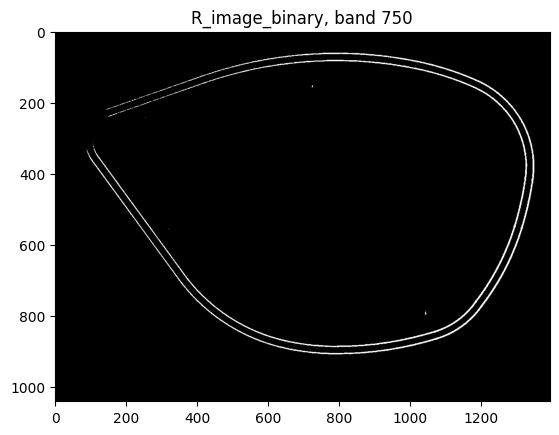

In [47]:
R_image = R_sample[wavelengths.index(750), :, :]
R_image_norm = R_image / np.max(R_image)
R_image_norm = (R_image_norm * 255).astype(np.uint8)
_, R_image_binary = cv2.threshold(R_image_norm, 60, 255, cv2.THRESH_BINARY_INV)

plt.imshow(R_image_binary, cmap="gray")
plt.title(f"R_image_binary, band {750}")
plt.show()

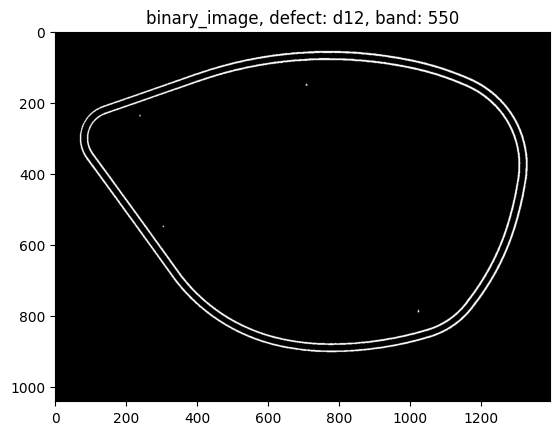

In [34]:
def convert_binary_image(defect_cubes, defect, band):
    gray = get_example_reflectance(defect_cubes, defect, band)
    gray_norm_d12 = gray / np.max(gray)
    gray_norm_d12 = (gray_norm_d12 * 255).astype(np.uint8)
    _, binary_image = cv2.threshold(gray_norm_d12, 60, 255, cv2.THRESH_BINARY_INV)

    return binary_image


defect = "d12"

binary_image = convert_binary_image(defect_cubes, defect, band)

plt.imshow(binary_image, cmap="gray")
plt.title(f"binary_image, defect: {defect}, band: {band}")
plt.show()

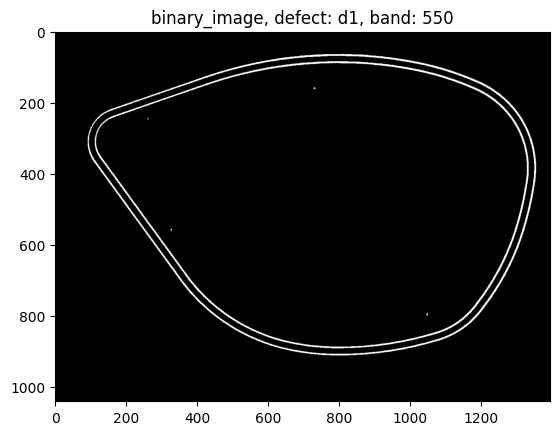

In [ ]:
defect = "d1"

binary_image = convert_binary_image(defect_cubes, defect, band)

plt.imshow(binary_image, cmap="gray")
plt.title(f"binary_image, defect: {defect}, band: {band}")
plt.show()

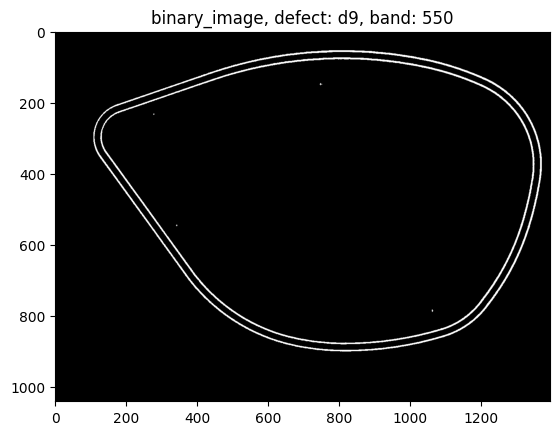

In [49]:
defect = "d9"

binary_image = convert_binary_image(defect_cubes, defect, band)

plt.imshow(binary_image, cmap="gray")
plt.title(f"binary_image, defect: {defect}, band: {band}")
plt.show()

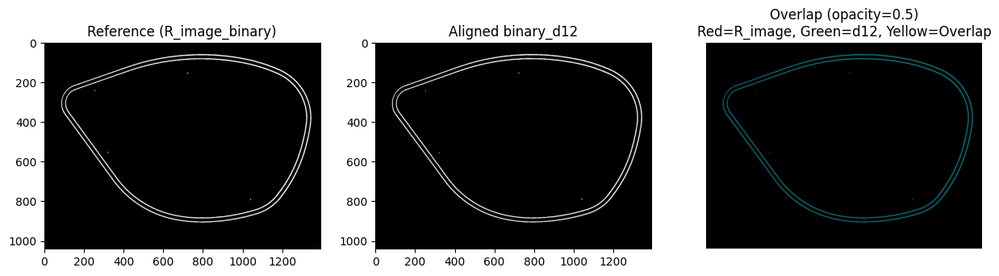

In [ ]:
def align_images(img_ref, img_to_align):
    orb = cv2.ORB_create(5000)
    kp1, des1 = orb.detectAndCompute(img_ref, None)
    kp2, des2 = orb.detectAndCompute(img_to_align, None)

    bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)
    matches = bf.match(des1, des2)
    matches = sorted(matches, key=lambda x: x.distance)
    good_matches = matches[:50]

    src_pts = np.float32([kp2[m.trainIdx].pt for m in good_matches]).reshape(-1, 1, 2)
    dst_pts = np.float32([kp1[m.queryIdx].pt for m in good_matches]).reshape(-1, 1, 2)

    H, mask = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 5.0)
    aligned = cv2.warpPerspective(img_to_align, H, (img_ref.shape[1], img_ref.shape[0]))
    return aligned, H


aligned_d12, H = align_images(R_image_binary, binary_d12)


img_ref_rgb = cv2.cvtColor(R_image_binary, cv2.COLOR_GRAY2BGR)
aligned_rgb = cv2.cvtColor(aligned_d12, cv2.COLOR_GRAY2BGR)


img_ref_coloured = np.zeros_like(img_ref_rgb)
img_ref_coloured[:, :, 2] = R_image_binary

aligned_coloured = np.zeros_like(aligned_rgb)
aligned_coloured[:, :, 1] = aligned_d12


alpha = 0.5
blended = cv2.addWeighted(img_ref_coloured, alpha, aligned_coloured, alpha, 0)


plt.figure(figsize=(15, 5))

plt.subplot(1, 3, 1)
plt.imshow(R_image_binary, cmap="gray")
plt.title("Reference (R_image_binary)")

plt.subplot(1, 3, 2)
plt.imshow(aligned_d12, cmap="gray")
plt.title("Aligned binary_d12")

plt.subplot(1, 3, 3)
plt.imshow(blended)
plt.title(f"Overlap (opacity={alpha})\nRed=R_image, Green=d12, Yellow=Overlap")
plt.axis("off")
plt.show()

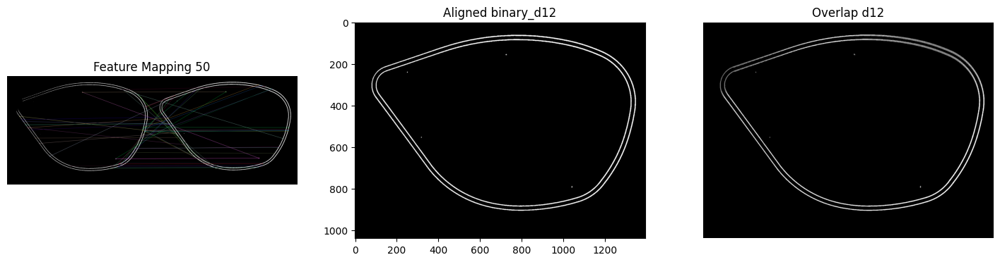

Homography (H):
 [[1.02190156e+00 3.96724626e-03 7.81172584e+00]
 [7.50001661e-03 1.01169085e+00 5.71538559e-01]
 [9.62512764e-06 5.41139978e-06 1.00000000e+00]]

Affine (A 2x3):
 [[ 1.00099823e+00 -1.31709880e-03  1.75178999e+01]
 [ 1.31709880e-03  1.00099823e+00  4.77005403e+00]]

Affine (A as 3x3):
 [[ 1.00099823e+00 -1.31709880e-03  1.75178999e+01]
 [ 1.31709880e-03  1.00099823e+00  4.77005403e+00]
 [ 0.00000000e+00  0.00000000e+00  1.00000000e+00]]

Affine decomposition:
  Translation (tx, ty): (17.52, 4.77)
  Scale (sx, sy): (1.001, 1.001)
  Rotation: 0.08°


In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import math


def align_and_visualise(img_ref, img_to_align, n_features=5000, n_good_matches=50):

    orb = cv2.ORB_create(n_features)
    kp1, des1 = orb.detectAndCompute(img_ref, None)
    kp2, des2 = orb.detectAndCompute(img_to_align, None)

    bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)
    matches = bf.match(des1, des2)
    matches = sorted(matches, key=lambda x: x.distance)
    good_matches = matches[:n_good_matches]

    pts_ref = np.float32([kp1[m.queryIdx].pt for m in good_matches]).reshape(-1, 2)
    pts_to = np.float32([kp2[m.trainIdx].pt for m in good_matches]).reshape(-1, 2)

    H, _ = cv2.findHomography(pts_to, pts_ref, cv2.RANSAC, 5.0)
    A, _ = cv2.estimateAffinePartial2D(pts_to, pts_ref, method=cv2.RANSAC)
    A_3x3 = np.vstack([A, [0, 0, 1]]) if A is not None else None

    aligned = cv2.warpPerspective(img_to_align, H, (img_ref.shape[1], img_ref.shape[0]))

    match_vis = cv2.drawMatches(
        cv2.cvtColor(img_ref, cv2.COLOR_GRAY2BGR),
        kp1,
        cv2.cvtColor(img_to_align, cv2.COLOR_GRAY2BGR),
        kp2,
        good_matches,
        None,
        flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS,
    )

    plt.figure(figsize=(18, 6))

    plt.subplot(1, 3, 1)
    plt.imshow(match_vis)
    plt.title(f"Feature Mapping {len(good_matches)}")
    plt.axis("off")

    plt.subplot(1, 3, 2)
    plt.imshow(aligned, cmap="gray")
    plt.title("Aligned binary_d12")

    plt.subplot(1, 3, 3)
    overlay = cv2.addWeighted(
        cv2.cvtColor(img_ref, cv2.COLOR_GRAY2BGR),
        0.5,
        cv2.cvtColor(aligned, cv2.COLOR_GRAY2BGR),
        0.5,
        0,
    )
    plt.imshow(overlay)
    plt.title("Overlap d12")
    plt.axis("off")

    plt.show()

    print("Homography (H):\n", H)
    print("\nAffine (A 2x3):\n", A)
    print("\nAffine (A as 3x3):\n", A_3x3)

    if A is not None:
        M = A[:, :2]
        tx, ty = A[:, 2]
        sx = np.linalg.norm(M[:, 0])
        sy = np.linalg.norm(M[:, 1])
        theta = math.atan2(M[1, 0], M[0, 0])
        print(f"\nAffine decomposition:")
        print(f"  Translation (tx, ty): ({tx:.2f}, {ty:.2f})")
        print(f"  Scale (sx, sy): ({sx:.3f}, {sy:.3f})")
        print(f"  Rotation: {math.degrees(theta):.2f}°")

    return H, A, A_3x3


H, A, A_3x3 = align_and_visualise(R_image_binary, binary_d12)

In [37]:
ref_RGB = R_sample[
    [wavelengths.index(650), wavelengths.index(550), wavelengths.index(470)],
    :,
    :,
]

d12_RGB = defect_cubes["d12"][
    [wavelengths.index(650), wavelengths.index(550), wavelengths.index(470)],
    :,
    :,
]

print(f"ref_RGB.shape: {ref_RGB.shape}")
print(f"d12_RGB.shape: {d12_RGB.shape}")

ref_RGB.shape: (3, 1040, 1392)
d12_RGB.shape: (3, 1040, 1392)


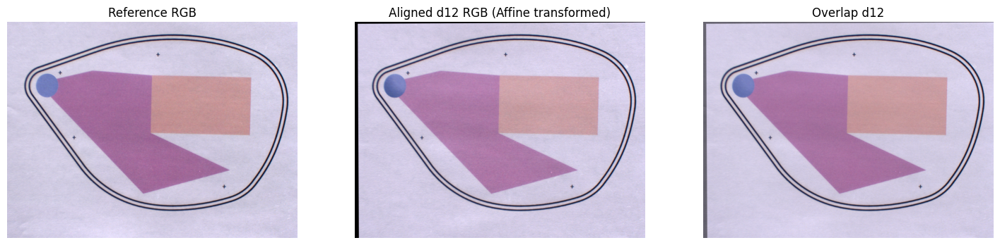

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt


A_3x3 = np.array(
    [
        [1.00125215, 0.00530952401, 14.2108351],
        [-0.00530952401, 1.00125215, 9.36152722],
        [0, 0, 1],
    ],
    dtype=np.float32,
)


A_2x3 = A_3x3[:2, :]


ref_rgb = np.moveaxis(ref_RGB, 0, -1)
d12_rgb = np.moveaxis(d12_RGB, 0, -1)


if ref_rgb.dtype != np.uint8:
    ref_rgb = np.clip(ref_rgb * 255, 0, 255).astype(np.uint8)
if d12_rgb.dtype != np.uint8:
    d12_rgb = np.clip(d12_rgb * 255, 0, 255).astype(np.uint8)


h, w = ref_rgb.shape[:2]
aligned_d12 = cv2.warpAffine(d12_rgb, A_2x3, (w, h))


alpha = 0.5
blended = cv2.addWeighted(ref_rgb, alpha, aligned_d12, alpha, 0)


plt.figure(figsize=(18, 6))
plt.subplot(1, 3, 1)
plt.imshow(ref_rgb)
plt.title("Reference RGB")
plt.axis("off")

plt.subplot(1, 3, 2)
plt.imshow(aligned_d12)
plt.title("Aligned d12 RGB (Affine transformed)")
plt.axis("off")

plt.subplot(1, 3, 3)
plt.imshow(blended)
plt.title(f"Overlap d12")
plt.axis("off")

plt.show()

In [39]:
# from sklearn.cluster import KMeans
# from scipy.ndimage import binary_fill_holes
# import numpy as np
# import cv2
# import matplotlib.pyplot as plt


# def compute_IC_mask(RGB_image):
#     RGB_image = RGB_image.astype(np.float32)
#     print(f"RGB_image.shape: {RGB_image.shape}")

#     if RGB_image.shape[0] == 3:
#         bands, height, width = RGB_image.shape
#         RGB_image = np.transpose(RGB_image, (1, 2, 0))
#     else:
#         height, width, bands = RGB_image.shape

#     pixels = RGB_image.reshape(-1, bands)
#     pixels /= np.linalg.norm(pixels, axis=1, keepdims=True) + 1e-6

#     k_means = KMeans(n_clusters=5, random_state=0, n_init=10)
#     labels = k_means.fit_predict(pixels)

#     segmented_image = labels.reshape(height, width)

#     pixel_IC = (300, 190)
#     IC_label = segmented_image[pixel_IC]
#     mask = (segmented_image == IC_label).astype(np.uint8)

#     flood_mask = mask.copy()
#     cv2.floodFill(flood_mask, None, (pixel_IC[1], pixel_IC[0]), 128)

#     circle_mask = np.uint8(flood_mask == 128)

#     kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (15, 15))
#     closed = cv2.morphologyEx(circle_mask, cv2.MORPH_CLOSE, kernel)
#     filled = binary_fill_holes(closed > 0)

#     plt.figure(figsize=(6, 6))
#     plt.imshow(filled, cmap="gray")
#     plt.axis("off")
#     plt.title("K-means segmented regions")
#     plt.show()

#     return segmented_image


# mask = compute_IC_mask(ref_rgb)

In [40]:
from sklearn.cluster import KMeans
from scipy.ndimage import binary_fill_holes
import numpy as np
import cv2
import matplotlib.pyplot as plt


def compute_IC_mask(RGB_image):
    RGB_image = RGB_image.astype(np.float32)

    if RGB_image.shape[0] == 3:
        bands, height, width = RGB_image.shape
        RGB_image = np.transpose(RGB_image, (1, 2, 0))
    else:
        height, width, bands = RGB_image.shape

    pixels = RGB_image.reshape(-1, bands)
    pixels /= np.linalg.norm(pixels, axis=1, keepdims=True) + 1e-6

    k_means = KMeans(n_clusters=5, random_state=0, n_init=10)
    labels = k_means.fit_predict(pixels)
    segmented_image = labels.reshape(height, width)

    # Select IC region
    pixel_IC = (300, 190)
    IC_label = segmented_image[pixel_IC]
    mask = (segmented_image == IC_label).astype(np.uint8)

    # Flood fill to isolate connected region
    flood_mask = mask.copy()
    cv2.floodFill(flood_mask, None, (pixel_IC[1], pixel_IC[0]), 128)
    circle_mask = np.uint8(flood_mask == 128)

    # Morphological closing
    kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (15, 15))
    closed = cv2.morphologyEx(circle_mask, cv2.MORPH_CLOSE, kernel)
    filled = binary_fill_holes(closed > 0)

    return filled.astype(np.uint8)


mask = compute_IC_mask(ref_rgb)

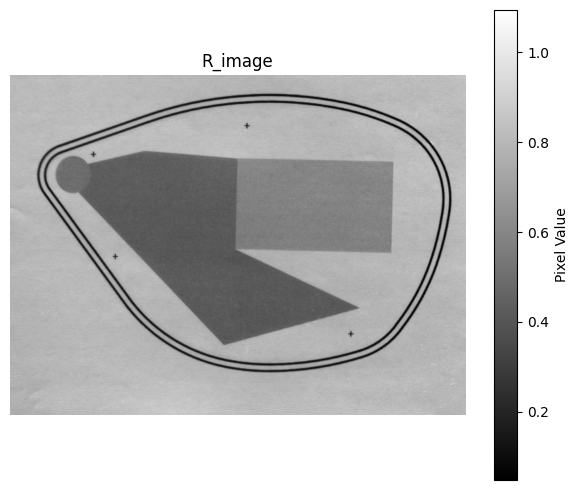

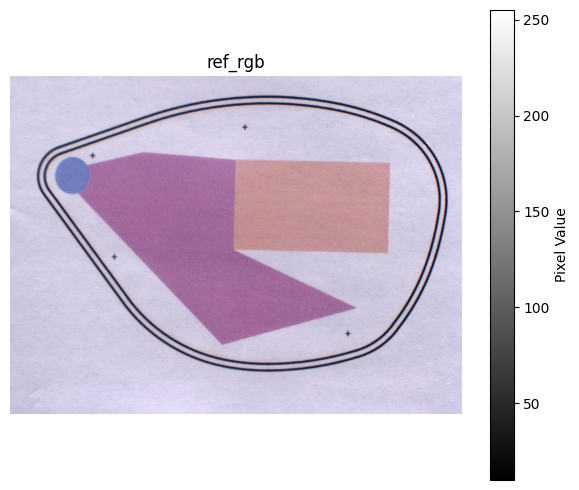

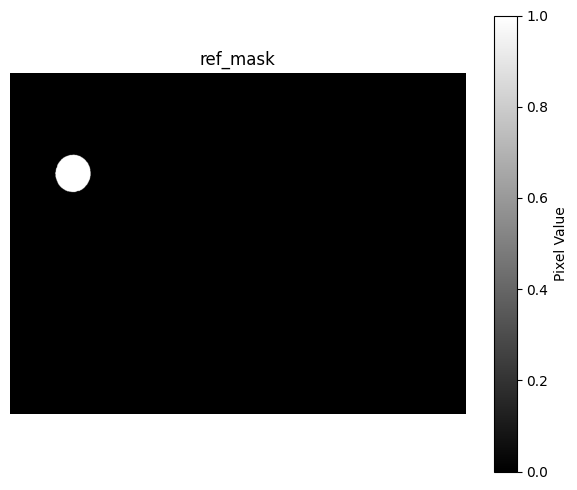

In [45]:
plot_image(R_image, "R_image")
plot_image(ref_rgb, "ref_rgb")
plot_image(mask, "ref_mask")

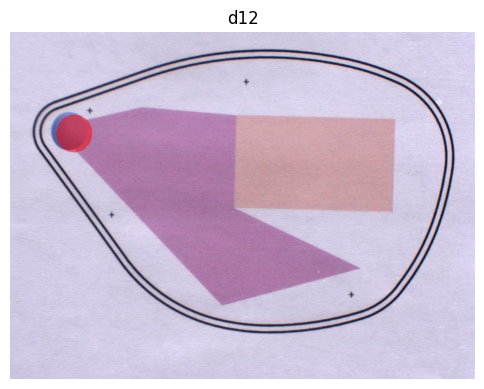

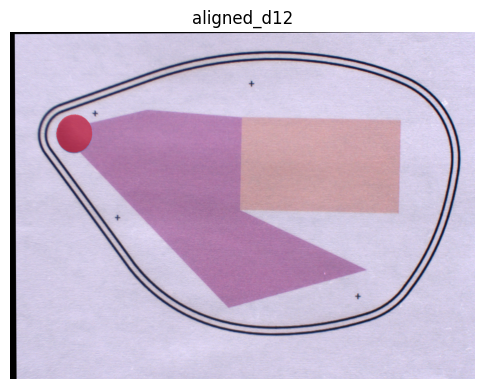

In [ ]:
def overlay_mask(base_image, mask, title, color=(1, 0, 0), alpha=0.5):
    base_image = base_image.astype(np.float32)
    if base_image.shape[0] == 3:
        base_image = np.transpose(base_image, (1, 2, 0))
    base_norm = base_image / 255.0 if base_image.max() > 1 else base_image

    overlay = np.zeros_like(base_norm)
    overlay[..., 0] = color[0]
    overlay[..., 1] = color[1]
    overlay[..., 2] = color[2]

    blended = base_norm.copy()
    blended[mask == 1] = (1 - alpha) * base_norm[mask == 1] + alpha * overlay[mask == 1]

    plt.figure(figsize=(6, 6))
    plt.imshow(np.clip(blended, 0, 1))
    plt.axis("off")
    plt.title(title)
    plt.show()


overlay_mask(d12_rgb, mask, "d12", color=(1, 0, 0), alpha=0.5)
overlay_mask(aligned_d12, mask, "aligned_d12", color=(1, 0, 0), alpha=0.5)

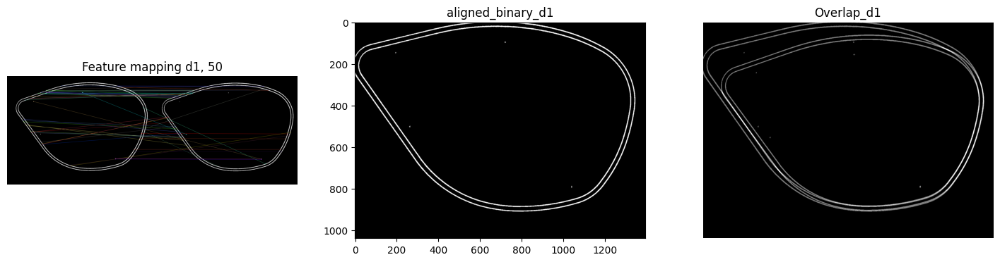


Affine (A as 3x3):
 [[ 9.98127898e-01  5.49397432e-03 -7.62823393e+00]
 [-5.49397432e-03  9.98127898e-01  3.79295797e+00]
 [ 0.00000000e+00  0.00000000e+00  1.00000000e+00]]

Affine decomposition:
  Translation (tx, ty): (-7.63, 3.79)
  Scale (sx, sy): (0.998, 0.998)
  Rotation: -0.32°


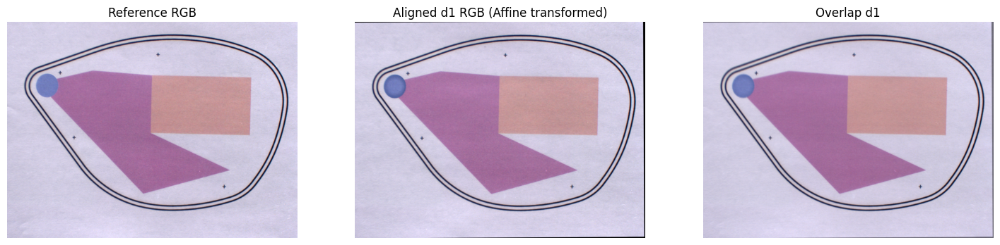

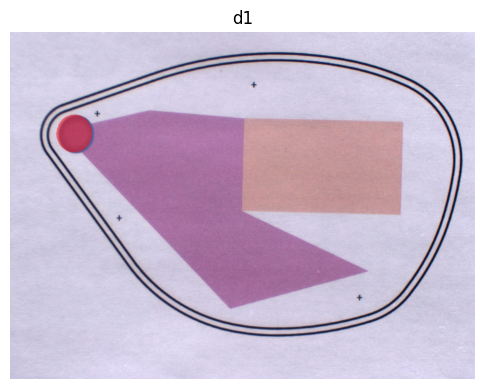

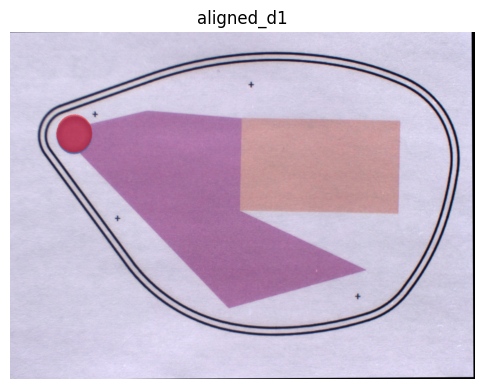

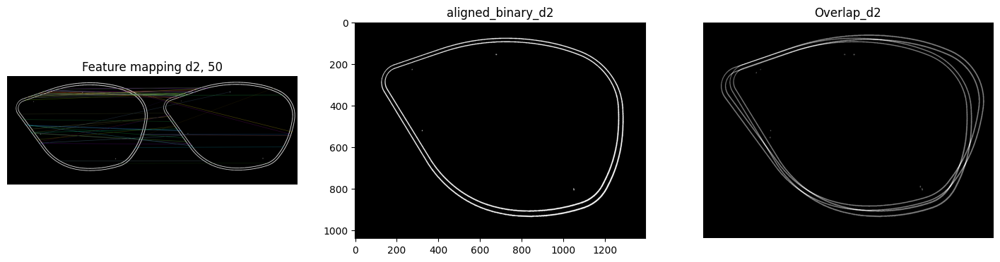


Affine (A as 3x3):
 [[ 9.99740153e-01  6.17398863e-03 -2.35394262e+01]
 [-6.17398863e-03  9.99740153e-01  9.43602856e+00]
 [ 0.00000000e+00  0.00000000e+00  1.00000000e+00]]

Affine decomposition:
  Translation (tx, ty): (-23.54, 9.44)
  Scale (sx, sy): (1.000, 1.000)
  Rotation: -0.35°


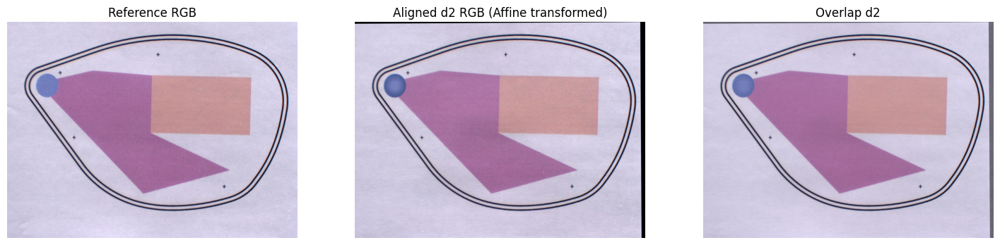

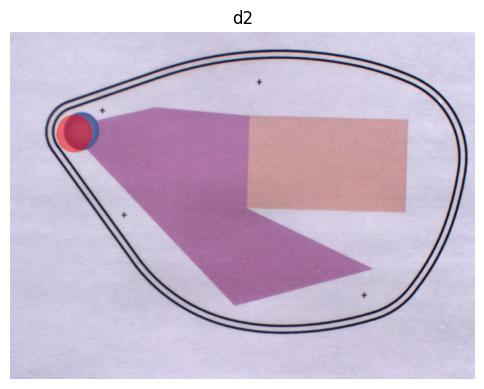

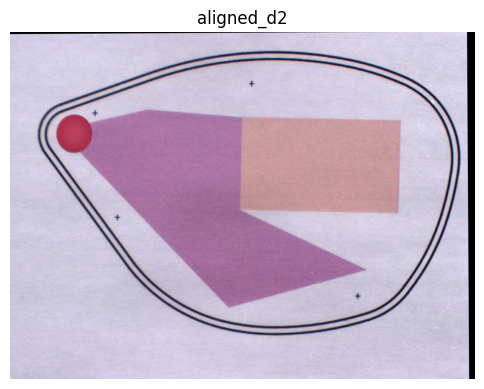

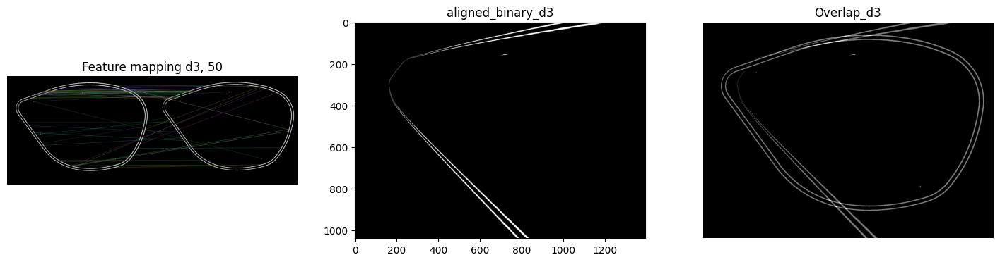


Affine (A as 3x3):
 [[ 1.02904138e+00  1.83454330e-02 -3.81042368e+01]
 [-1.83454330e-02  1.02904138e+00  1.35342157e+01]
 [ 0.00000000e+00  0.00000000e+00  1.00000000e+00]]

Affine decomposition:
  Translation (tx, ty): (-38.10, 13.53)
  Scale (sx, sy): (1.029, 1.029)
  Rotation: -1.02°


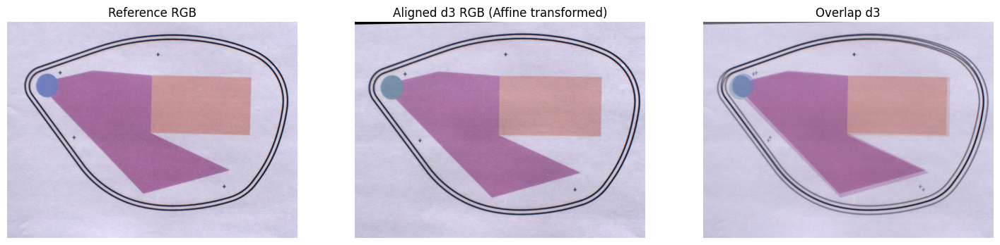

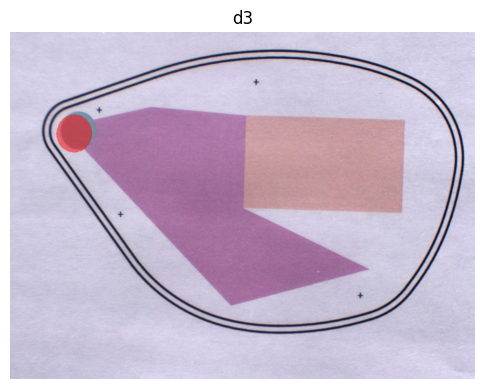

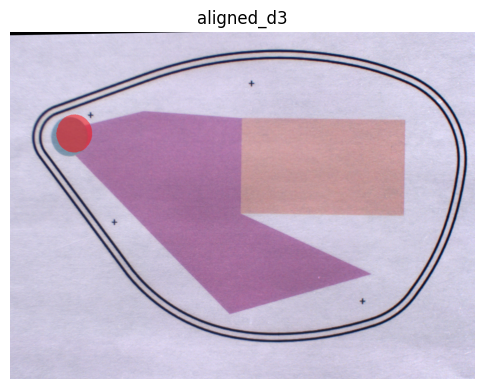

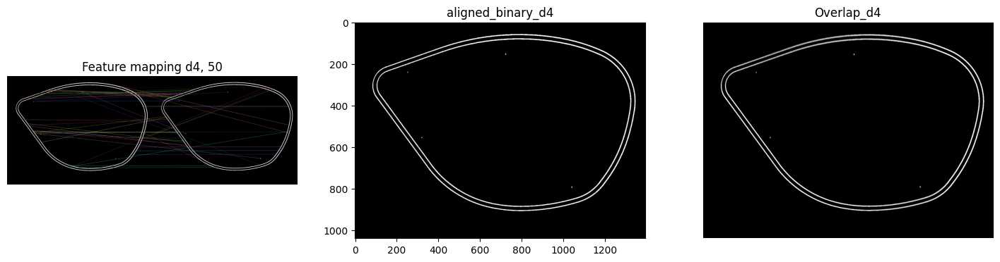


Affine (A as 3x3):
 [[ 1.00120035e+00  2.14718166e-03 -2.54984802e+00]
 [-2.14718166e-03  1.00120035e+00  4.48401754e+00]
 [ 0.00000000e+00  0.00000000e+00  1.00000000e+00]]

Affine decomposition:
  Translation (tx, ty): (-2.55, 4.48)
  Scale (sx, sy): (1.001, 1.001)
  Rotation: -0.12°


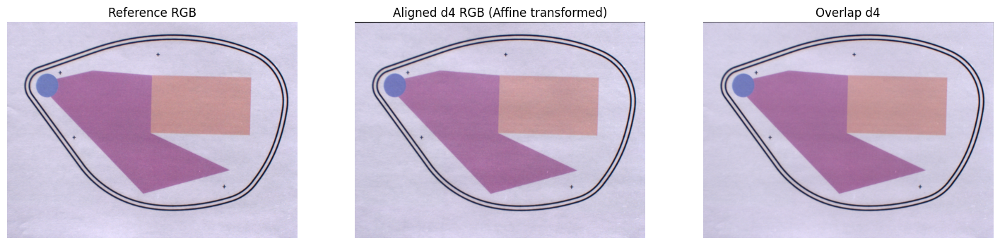

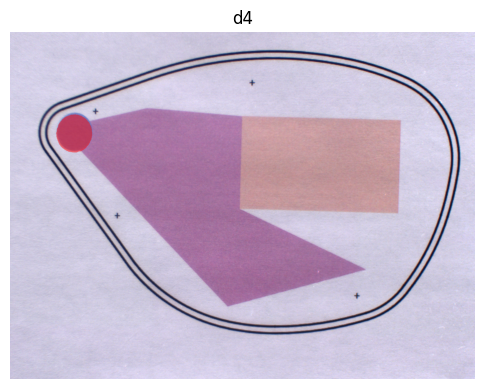

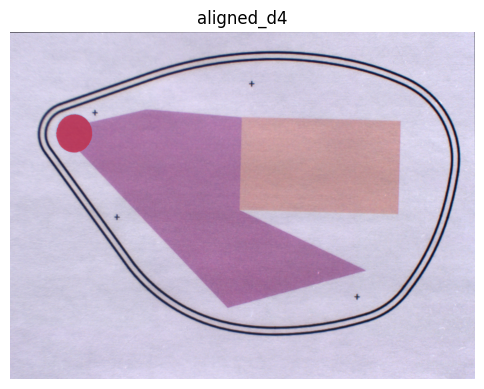

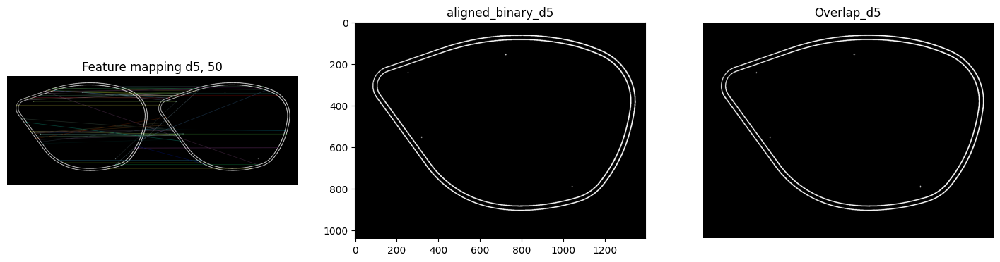


Affine (A as 3x3):
 [[ 9.99673354e-01 -8.96351151e-04  2.59137278e+01]
 [ 8.96351151e-04  9.99673354e-01 -2.71315200e-01]
 [ 0.00000000e+00  0.00000000e+00  1.00000000e+00]]

Affine decomposition:
  Translation (tx, ty): (25.91, -0.27)
  Scale (sx, sy): (1.000, 1.000)
  Rotation: 0.05°


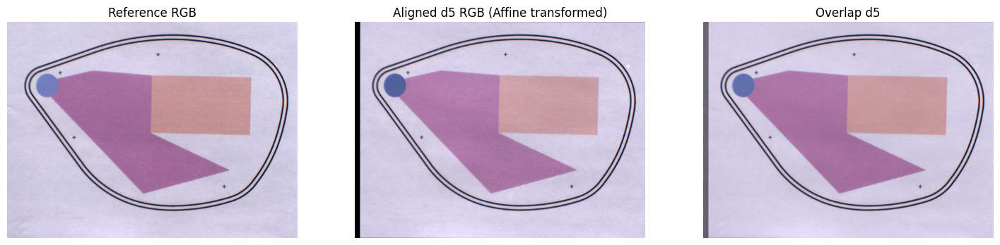

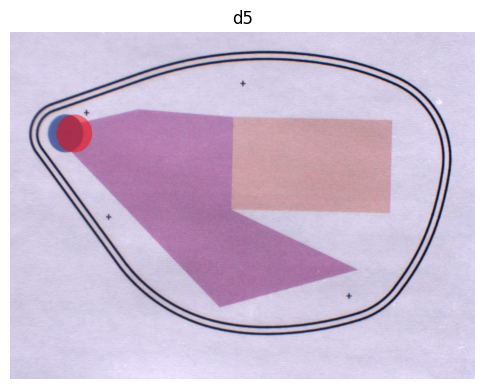

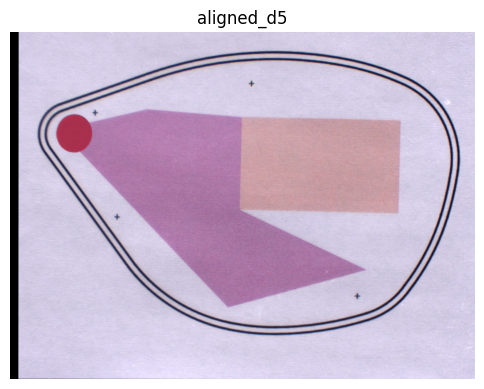

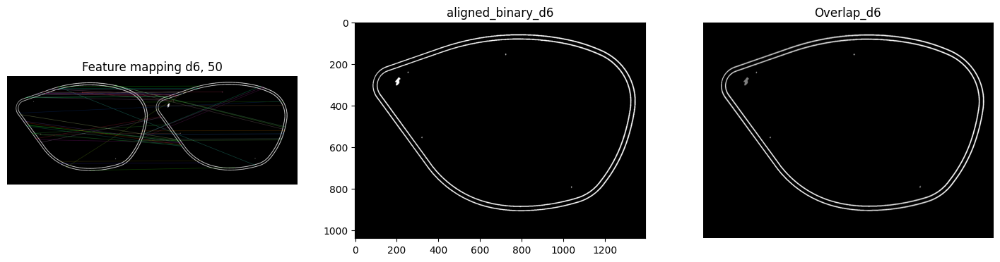


Affine (A as 3x3):
 [[ 1.00055429e+00  3.03712491e-03  5.08027179e+01]
 [-3.03712491e-03  1.00055429e+00  7.58416869e+00]
 [ 0.00000000e+00  0.00000000e+00  1.00000000e+00]]

Affine decomposition:
  Translation (tx, ty): (50.80, 7.58)
  Scale (sx, sy): (1.001, 1.001)
  Rotation: -0.17°


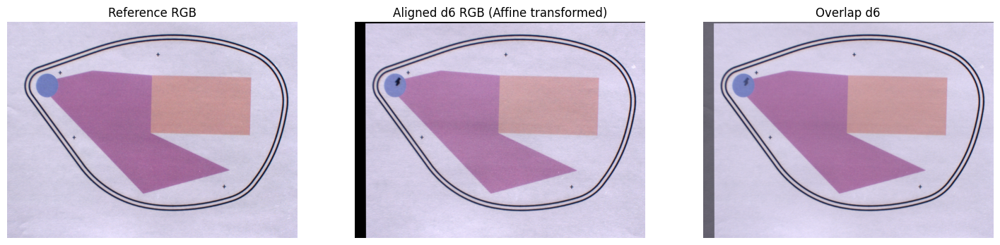

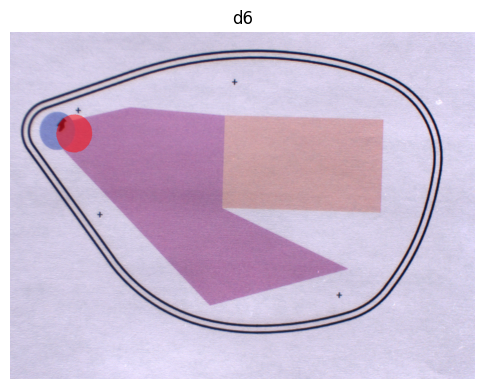

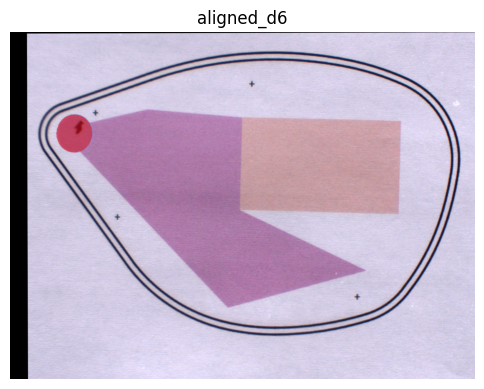

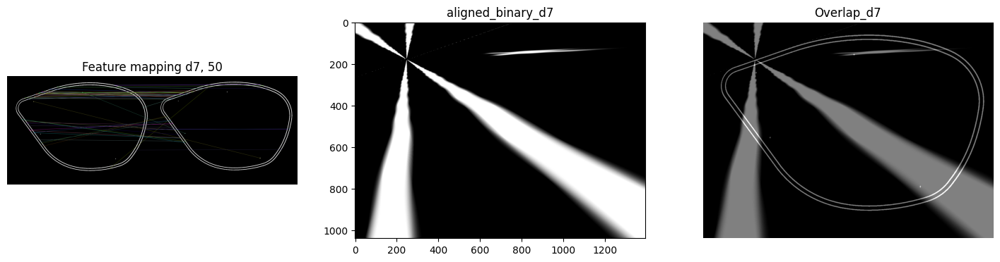


Affine (A as 3x3):
 [[ 9.99623324e-01 -4.77615882e-05  6.45387445e+00]
 [ 4.77615882e-05  9.99623324e-01  5.99689667e+00]
 [ 0.00000000e+00  0.00000000e+00  1.00000000e+00]]

Affine decomposition:
  Translation (tx, ty): (6.45, 6.00)
  Scale (sx, sy): (1.000, 1.000)
  Rotation: 0.00°


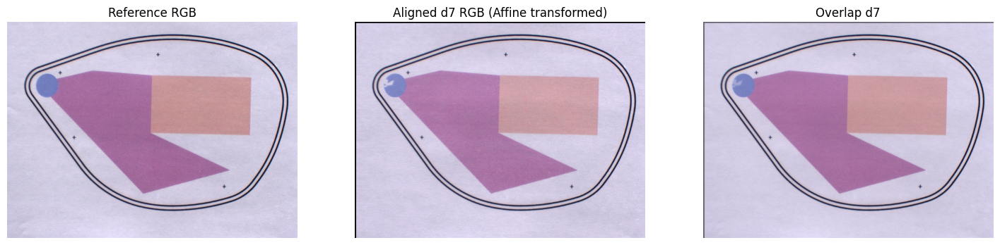

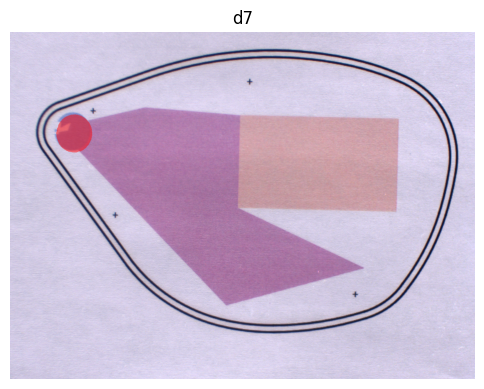

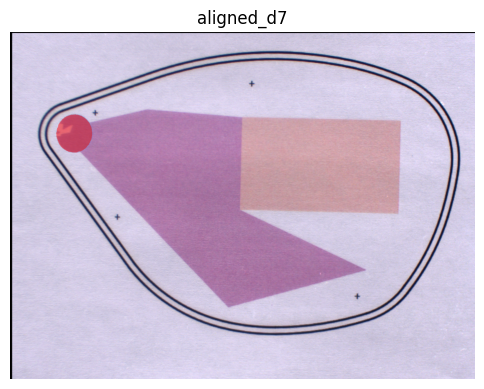

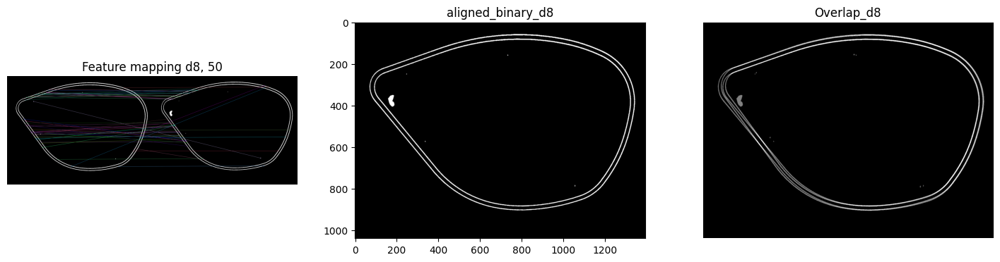


Affine (A as 3x3):
 [[ 9.99852460e-01  1.00398607e-03  2.16874711e-01]
 [-1.00398607e-03  9.99852460e-01  7.58854639e+00]
 [ 0.00000000e+00  0.00000000e+00  1.00000000e+00]]

Affine decomposition:
  Translation (tx, ty): (0.22, 7.59)
  Scale (sx, sy): (1.000, 1.000)
  Rotation: -0.06°


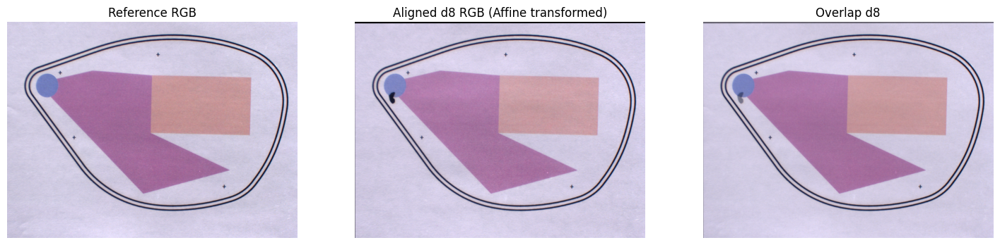

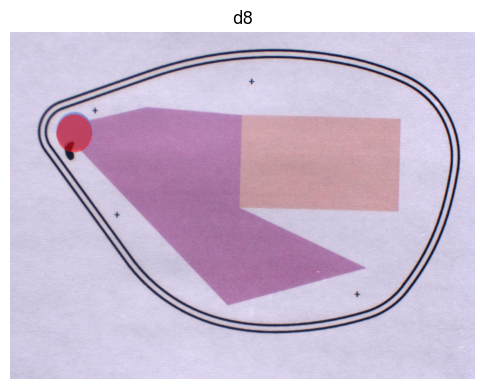

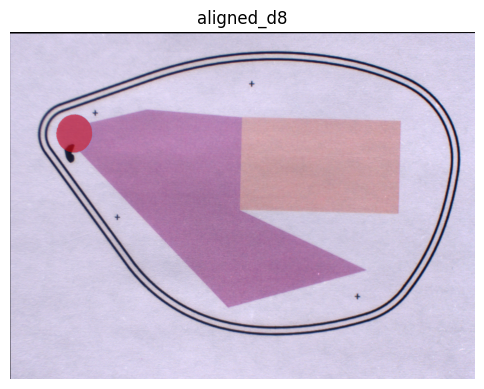

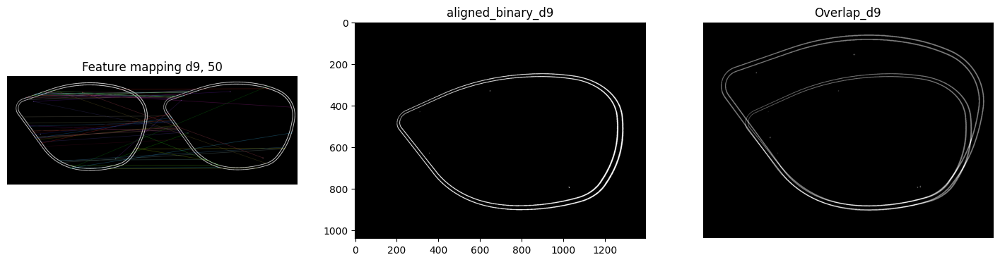


Affine (A as 3x3):
 [[ 1.00052268e+00  1.72240852e-03 -2.43667463e+01]
 [-1.72240852e-03  1.00052268e+00  8.54047332e+00]
 [ 0.00000000e+00  0.00000000e+00  1.00000000e+00]]

Affine decomposition:
  Translation (tx, ty): (-24.37, 8.54)
  Scale (sx, sy): (1.001, 1.001)
  Rotation: -0.10°


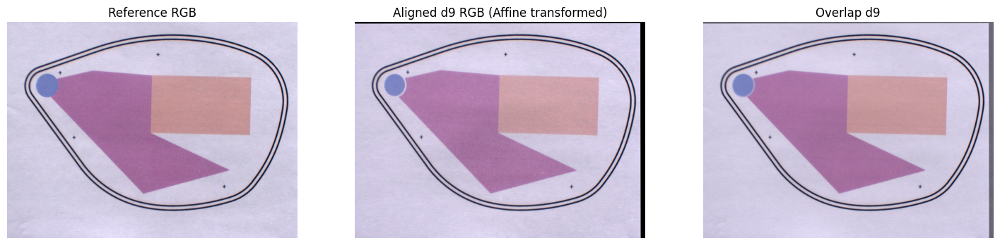

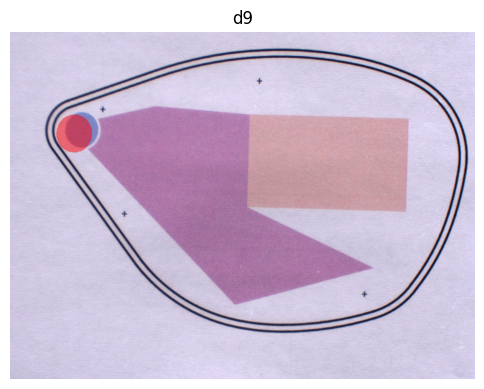

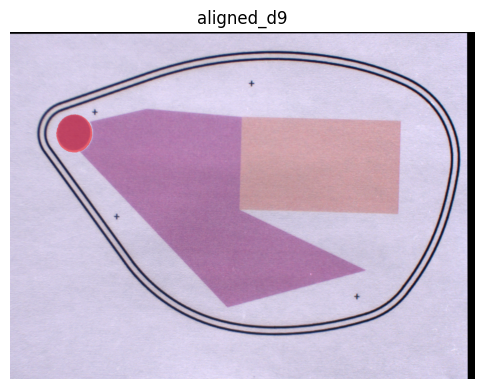

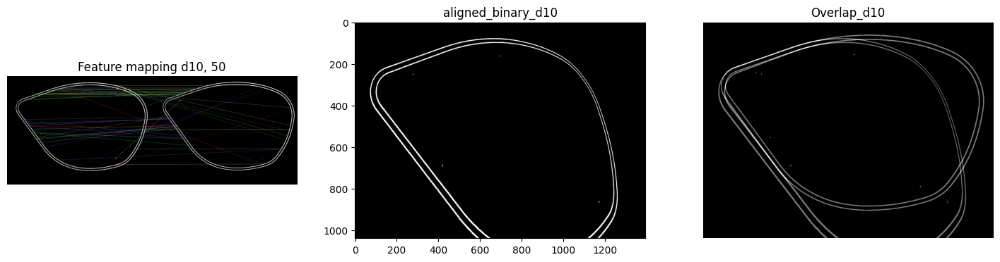


Affine (A as 3x3):
 [[ 1.00027778e+00  3.03639487e-03 -1.76388811e+01]
 [-3.03639487e-03  1.00027778e+00  7.53026909e+00]
 [ 0.00000000e+00  0.00000000e+00  1.00000000e+00]]

Affine decomposition:
  Translation (tx, ty): (-17.64, 7.53)
  Scale (sx, sy): (1.000, 1.000)
  Rotation: -0.17°


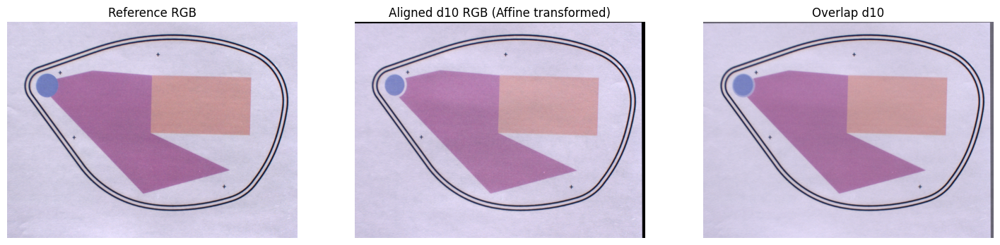

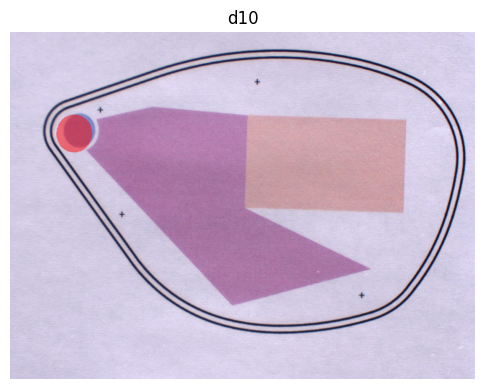

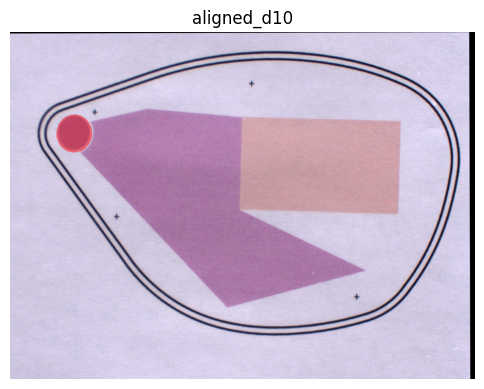

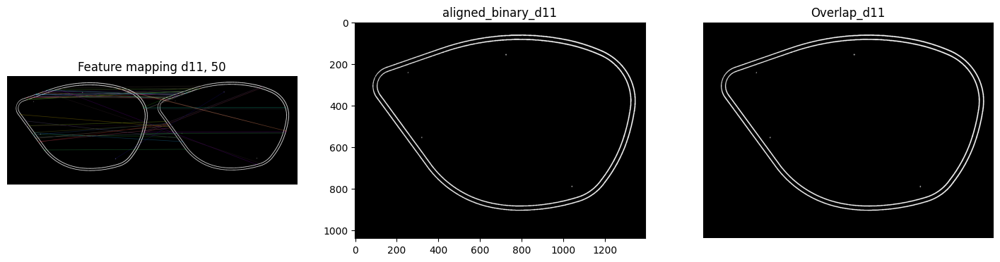


Affine (A as 3x3):
 [[ 1.00029340e+00  3.66080142e-03  3.46951416e+01]
 [-3.66080142e-03  1.00029340e+00  7.37736353e+00]
 [ 0.00000000e+00  0.00000000e+00  1.00000000e+00]]

Affine decomposition:
  Translation (tx, ty): (34.70, 7.38)
  Scale (sx, sy): (1.000, 1.000)
  Rotation: -0.21°


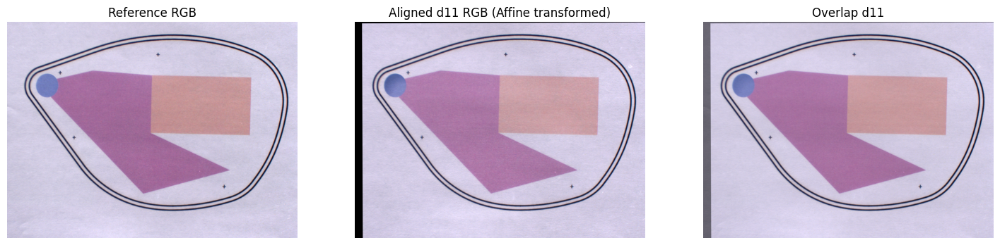

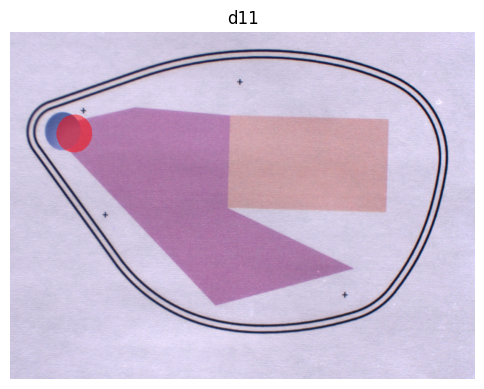

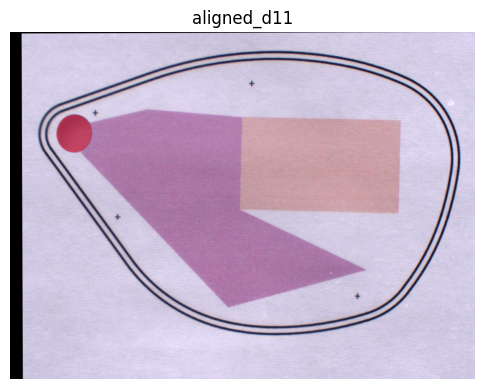

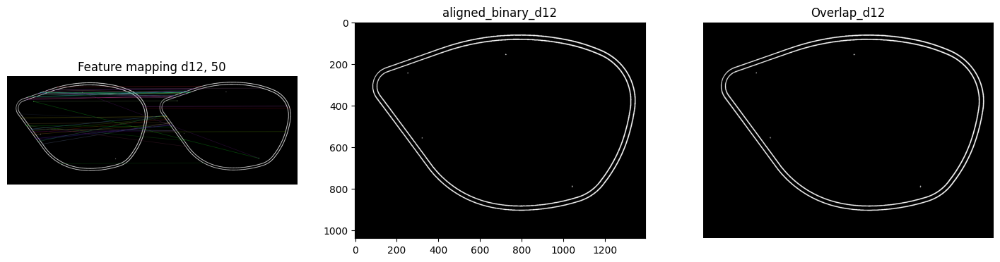


Affine (A as 3x3):
 [[ 1.00125215e+00  5.30952401e-03  1.42108351e+01]
 [-5.30952401e-03  1.00125215e+00  9.36152722e+00]
 [ 0.00000000e+00  0.00000000e+00  1.00000000e+00]]

Affine decomposition:
  Translation (tx, ty): (14.21, 9.36)
  Scale (sx, sy): (1.001, 1.001)
  Rotation: -0.30°


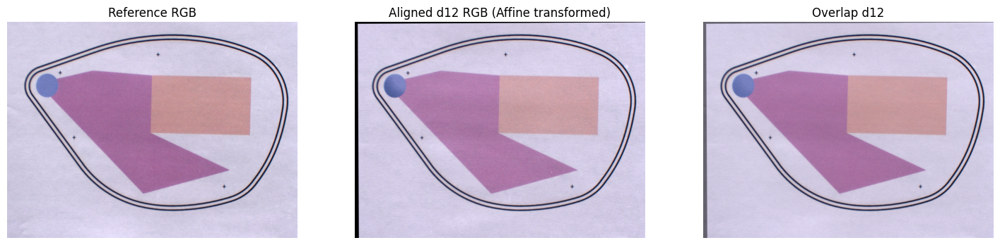

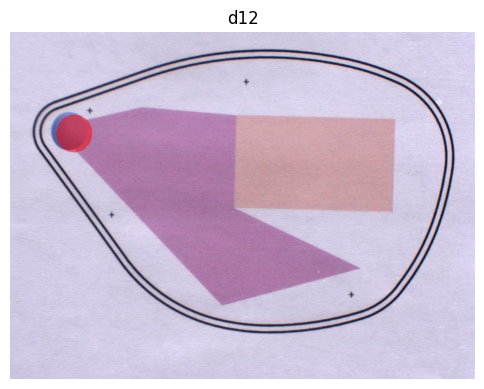

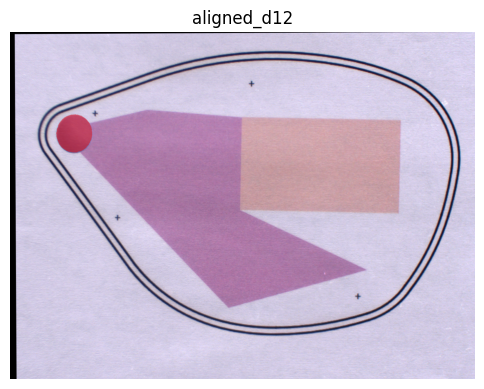

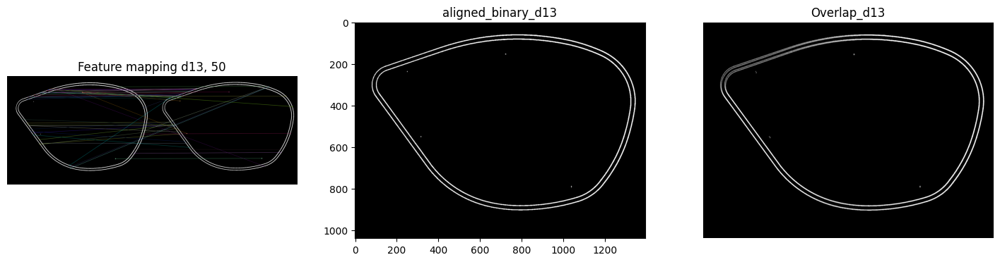


Affine (A as 3x3):
 [[ 1.00293630e+00 -6.38278295e-03 -1.29897685e+01]
 [ 6.38278295e-03  1.00293630e+00 -2.69899034e+00]
 [ 0.00000000e+00  0.00000000e+00  1.00000000e+00]]

Affine decomposition:
  Translation (tx, ty): (-12.99, -2.70)
  Scale (sx, sy): (1.003, 1.003)
  Rotation: 0.36°


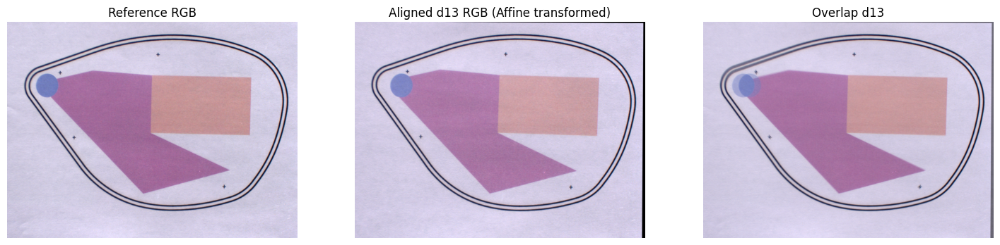

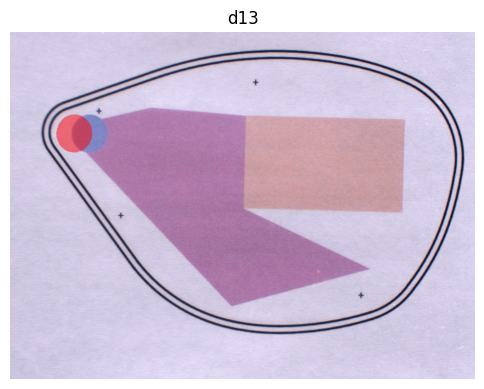

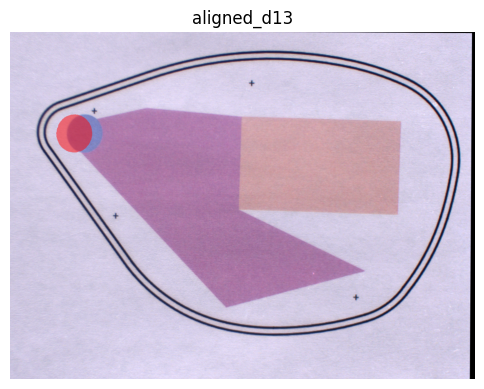

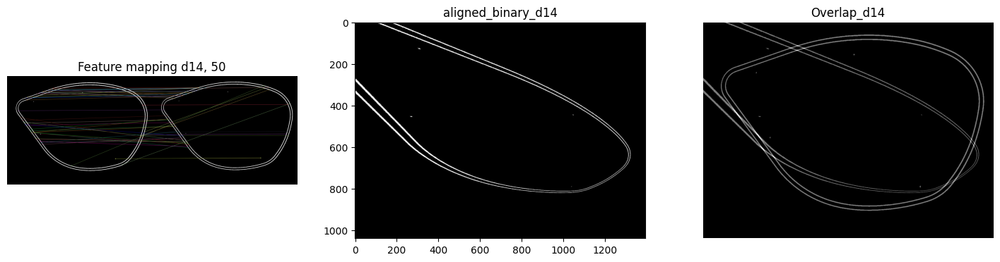


Affine (A as 3x3):
 [[ 9.99494223e-01  1.01581194e-03 -3.58883347e-01]
 [-1.01581194e-03  9.99494223e-01  7.99680298e+00]
 [ 0.00000000e+00  0.00000000e+00  1.00000000e+00]]

Affine decomposition:
  Translation (tx, ty): (-0.36, 8.00)
  Scale (sx, sy): (0.999, 0.999)
  Rotation: -0.06°


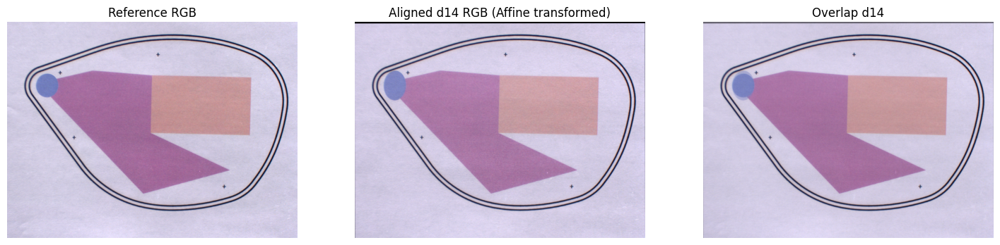

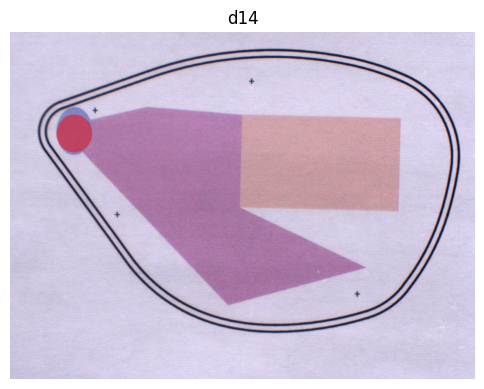

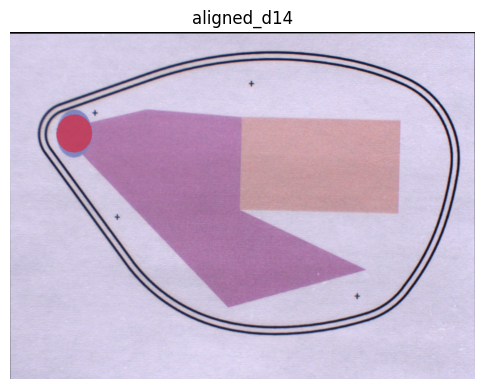

In [ ]:
defects = [
    "d1",
    "d2",
    "d3",
    "d4",
    "d5",
    "d6",
    "d7",
    "d8",
    "d9",
    "d10",
    "d11",
    "d12",
    "d13",
    "d14",
]
band = 550


def align_and_visualise(
    img_ref, img_to_align, defect, n_features=5000, n_good_matches=50
):
    orb = cv2.ORB_create(n_features)
    kp1, des1 = orb.detectAndCompute(img_ref, None)
    kp2, des2 = orb.detectAndCompute(img_to_align, None)

    bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)
    matches = bf.match(des1, des2)
    matches = sorted(matches, key=lambda x: x.distance)
    good_matches = matches[:n_good_matches]

    pts_ref = np.float32([kp1[m.queryIdx].pt for m in good_matches]).reshape(-1, 2)
    pts_to = np.float32([kp2[m.trainIdx].pt for m in good_matches]).reshape(-1, 2)

    H, _ = cv2.findHomography(pts_to, pts_ref, cv2.RANSAC, 5.0)
    A, _ = cv2.estimateAffinePartial2D(pts_to, pts_ref, method=cv2.RANSAC)
    A_3x3 = np.vstack([A, [0, 0, 1]]) if A is not None else None

    aligned = cv2.warpPerspective(img_to_align, H, (img_ref.shape[1], img_ref.shape[0]))

    match_vis = cv2.drawMatches(
        cv2.cvtColor(img_ref, cv2.COLOR_GRAY2BGR),
        kp1,
        cv2.cvtColor(img_to_align, cv2.COLOR_GRAY2BGR),
        kp2,
        good_matches,
        None,
        flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS,
    )

    plt.figure(figsize=(18, 6))

    plt.subplot(1, 3, 1)
    plt.imshow(match_vis)
    plt.title(f"Feature mapping {defect}, {len(good_matches)}")
    plt.axis("off")

    plt.subplot(1, 3, 2)
    plt.imshow(aligned, cmap="gray")
    plt.title(f"aligned_binary_{defect}")

    plt.subplot(1, 3, 3)
    overlay = cv2.addWeighted(
        cv2.cvtColor(img_ref, cv2.COLOR_GRAY2BGR),
        0.5,
        cv2.cvtColor(aligned, cv2.COLOR_GRAY2BGR),
        0.5,
        0,
    )
    plt.imshow(overlay)
    plt.title(f"Overlap_{defect}")
    plt.axis("off")

    plt.show()

    print("\nAffine (A as 3x3):\n", A_3x3)

    if A is not None:
        M = A[:, :2]
        tx, ty = A[:, 2]
        sx = np.linalg.norm(M[:, 0])
        sy = np.linalg.norm(M[:, 1])
        theta = math.atan2(M[1, 0], M[0, 0])
        print(f"\nAffine decomposition:")
        print(f"  Translation (tx, ty): ({tx:.2f}, {ty:.2f})")
        print(f"  Scale (sx, sy): ({sx:.3f}, {sy:.3f})")
        print(f"  Rotation: {math.degrees(theta):.2f}°")

    return A_3x3


for i in range(len(defects)):
    binary_image = convert_binary_image(defect_cubes, defects[i], band)
    A_3x3 = align_and_visualise(R_image_binary, binary_image, defects[i])

    ref_RGB = R_sample[
        [wavelengths.index(650), wavelengths.index(550), wavelengths.index(470)],
        :,
        :,
    ]

    defect_RGB = defect_cubes[defects[i]][
        [wavelengths.index(650), wavelengths.index(550), wavelengths.index(470)],
        :,
        :,
    ]

    A_2x3 = A_3x3[:2, :]

    ref_rgb = np.moveaxis(ref_RGB, 0, -1)
    defect_rgb = np.moveaxis(defect_RGB, 0, -1)

    if ref_rgb.dtype != np.uint8:
        ref_rgb = np.clip(ref_rgb * 255, 0, 255).astype(np.uint8)
    if defect_rgb.dtype != np.uint8:
        defect_rgb = np.clip(defect_rgb * 255, 0, 255).astype(np.uint8)

    h, w = ref_rgb.shape[:2]
    aligned_defect = cv2.warpAffine(defect_rgb, A_2x3, (w, h))

    alpha = 0.5
    blended = cv2.addWeighted(ref_rgb, alpha, aligned_defect, alpha, 0)

    plt.figure(figsize=(18, 6))
    plt.subplot(1, 3, 1)
    plt.imshow(ref_rgb)
    plt.title("Reference RGB")
    plt.axis("off")

    plt.subplot(1, 3, 2)
    plt.imshow(aligned_defect)
    plt.title(f"Aligned {defects[i]} RGB (Affine transformed)")
    plt.axis("off")

    plt.subplot(1, 3, 3)
    plt.imshow(blended)
    plt.title(f"Overlap {defects[i]}")
    plt.axis("off")

    overlay_mask(defect_rgb, mask, defects[i], color=(1, 0, 0), alpha=0.5)
    overlay_mask(
        aligned_defect, mask, f"aligned_{defects[i]}", color=(1, 0, 0), alpha=0.5
    )